# CLIP

https://openai.com/blog/clip/

{code adapted from @robgon-art}

Using this notebook to filter the fetched images based on a measure of similarity with a given phrase.

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import numpy as np
import PIL
from PIL import Image
import os
import os.path
import pickle

In [ ]:
!mkdir '/content/drive/MyDrive/tesi2/impressionist_landscape_1024'

In [1]:
#Resizing images as they should be 1024x1024

IMAGE_SIZE = 1024
IMAGE_CHANNELS = 3
IMAGE_DIR = '/content/drive/MyDrive/tesi2/impressionist_landscapes/'

# Defining image dir path. Change this if you have different directory
images_path = IMAGE_DIR

image_count = 0

for file in os.listdir(IMAGE_DIR):
  path = os.path.join(IMAGE_DIR,file)
  im = Image.open(path)
  image = im.convert('RGB')
  image = image.resize((IMAGE_SIZE, IMAGE_SIZE), Image.ANTIALIAS)
  output_path = '/content/drive/MyDrive/tesi2/impressionist_landscape_1024'
  filename = os.path.join(output_path, f"resized-{image_count}.png")
  image.save(filename)
  image_count += 1
  print("\nImage resized:", image_count, "\nTot img resized:",filename)


"""
for artist in os.listdir(images_path):
  artist_path = os.path.join(images_path,artist)

  for file in os.listdir(artist_path):
    path = os.path.join(artist_path,file)
    im = Image.open(path)
    image = im.convert('RGB')
    image = image.resize((IMAGE_SIZE, IMAGE_SIZE), Image.ANTIALIAS)
    output_path = '/content/drive/MyDrive/tesi2/impressionist_landscape_1024'
    filename = os.path.join(output_path, f"resized-{image_count}.png")
    image.save(filename)
    image_count += 1
    print("\nImage resized:", image_count, "\nTot img resized:",filename)

"""

NameError: name 'os' is not defined

In [ ]:
import glob
image_files = sorted(glob.glob('/content/drive/MyDrive/tesi2/impressionist_landscape_1024/*'))
print(len(image_files))
print(image_files[:4])

3368
['/content/drive/MyDrive/tesi2/impressionist_landscape_1024/resized-0.png', '/content/drive/MyDrive/tesi2/impressionist_landscape_1024/resized-1.png', '/content/drive/MyDrive/tesi2/impressionist_landscape_1024/resized-10.png', '/content/drive/MyDrive/tesi2/impressionist_landscape_1024/resized-100.png']


In [ ]:
import numpy as np
import torch
print("Torch version:", torch.__version__)

Torch version: 1.10.0+cu111


In [ ]:
!wget https://openaipublic.azureedge.net/clip/models/40d365715913c9da98579312b702a82c18be219cc2a73407c4526f58eba950af/ViT-B-32.pt -O model.pt

--2022-01-22 09:48:39--  https://openaipublic.azureedge.net/clip/models/40d365715913c9da98579312b702a82c18be219cc2a73407c4526f58eba950af/ViT-B-32.pt
Resolving openaipublic.azureedge.net (openaipublic.azureedge.net)... 13.107.246.39, 13.107.213.39, 2620:1ec:bdf::39, ...
Connecting to openaipublic.azureedge.net (openaipublic.azureedge.net)|13.107.246.39|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 353976522 (338M) [application/octet-stream]
Saving to: ‘model.pt’

model.pt            100%[===================>] 337.58M  63.4MB/s    in 5.3s    

2022-01-22 09:48:44 (63.2 MB/s) - ‘model.pt’ saved [353976522/353976522]



In [ ]:
model = torch.jit.load("model.pt").cuda().eval()
input_resolution = model.input_resolution.item()
context_length = model.context_length.item()
vocab_size = model.vocab_size.item()

print("Model parameters:", f"{np.sum([int(np.prod(p.shape)) for p in model.parameters()]):,}")
print("Input resolution:", input_resolution)
print("Context length:", context_length)
print("Vocab size:", vocab_size)

Model parameters: 151,277,313
Input resolution: 224
Context length: 77
Vocab size: 49408


In [ ]:
from torchvision.transforms import Compose, Resize, CenterCrop, ToTensor, Normalize
from PIL import Image

preprocess = Compose([
    Resize(input_resolution, interpolation=Image.BICUBIC),
    ToTensor()
])

image_mean = torch.tensor([0.48145466, 0.4578275, 0.40821073]).cuda()
image_std = torch.tensor([0.26862954, 0.26130258, 0.27577711]).cuda()

/usr/local/lib/python3.7/dist-packages/torchvision/transforms/transforms.py:288: UserWarning: Argument interpolation should be of type InterpolationMode instead of int. Please, use InterpolationMode enum.
  "Argument interpolation should be of type InterpolationMode instead of int. "


In [ ]:
!wget https://openaipublic.azureedge.net/clip/bpe_simple_vocab_16e6.txt.gz -O bpe_simple_vocab_16e6.txt.gz

--2022-01-22 09:48:45--  https://openaipublic.azureedge.net/clip/bpe_simple_vocab_16e6.txt.gz
Resolving openaipublic.azureedge.net (openaipublic.azureedge.net)... 13.107.246.39, 13.107.213.39, 2620:1ec:bdf::39, ...
Connecting to openaipublic.azureedge.net (openaipublic.azureedge.net)|13.107.246.39|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1356917 (1.3M) [application/octet-stream]
Saving to: ‘bpe_simple_vocab_16e6.txt.gz’

bpe_simple_vocab_16 100%[===================>]   1.29M  6.02MB/s    in 0.2s    

2022-01-22 09:48:45 (6.02 MB/s) - ‘bpe_simple_vocab_16e6.txt.gz’ saved [1356917/1356917]



In [ ]:
!pip install ftfy

In [ ]:
import os
from functools import lru_cache
import ftfy
import regex as re

@lru_cache()
def bytes_to_unicode():
    """
    Returns list of utf-8 byte and a corresponding list of unicode strings.
    The reversible bpe codes work on unicode strings.
    This means you need a large # of unicode characters in your vocab if you want to avoid UNKs.
    When you're at something like a 10B token dataset you end up needing around 5K for decent coverage.
    This is a signficant percentage of your normal, say, 32K bpe vocab.
    To avoid that, we want lookup tables between utf-8 bytes and unicode strings.
    And avoids mapping to whitespace/control characters the bpe code barfs on.
    """
    bs = list(range(ord("!"), ord("~")+1))+list(range(ord("¡"), ord("¬")+1))+list(range(ord("®"), ord("ÿ")+1))
    cs = bs[:]
    n = 0
    for b in range(2**8):
        if b not in bs:
            bs.append(b)
            cs.append(2**8+n)
            n += 1
    cs = [chr(n) for n in cs]
    return dict(zip(bs, cs))


def get_pairs(word):
    """Return set of symbol pairs in a word.
    Word is represented as tuple of symbols (symbols being variable-length strings).
    """
    pairs = set()
    prev_char = word[0]
    for char in word[1:]:
        pairs.add((prev_char, char))
        prev_char = char
    return pairs

def basic_clean(text):
    text = ftfy.fix_text(text)
    text = html.unescape(html.unescape(text))
    return text.strip()

def whitespace_clean(text):
    text = re.sub(r'\s+', ' ', text)
    text = text.strip()
    return text

class SimpleTokenizer(object):
    def __init__(self, bpe_path: str = "bpe_simple_vocab_16e6.txt.gz"):
        self.byte_encoder = bytes_to_unicode()
        self.byte_decoder = {v: k for k, v in self.byte_encoder.items()}
        merges = gzip.open(bpe_path).read().decode("utf-8").split('\n')
        merges = merges[1:49152-256-2+1]
        merges = [tuple(merge.split()) for merge in merges]
        vocab = list(bytes_to_unicode().values())
        vocab = vocab + [v+'</w>' for v in vocab]
        for merge in merges:
            vocab.append(''.join(merge))
        vocab.extend(['<|startoftext|>', '<|endoftext|>'])
        self.encoder = dict(zip(vocab, range(len(vocab))))
        self.decoder = {v: k for k, v in self.encoder.items()}
        self.bpe_ranks = dict(zip(merges, range(len(merges))))
        self.cache = {'<|startoftext|>': '<|startoftext|>', '<|endoftext|>': '<|endoftext|>'}
        self.pat = re.compile(r"""<\|startoftext\|>|<\|endoftext\|>|'s|'t|'re|'ve|'m|'ll|'d|[\p{L}]+|[\p{N}]|[^\s\p{L}\p{N}]+""", re.IGNORECASE)

    def bpe(self, token):
        if token in self.cache:
            return self.cache[token]
        word = tuple(token[:-1]) + ( token[-1] + '</w>',)
        pairs = get_pairs(word)

        if not pairs:
            return token+'</w>'

        while True:
            bigram = min(pairs, key = lambda pair: self.bpe_ranks.get(pair, float('inf')))
            if bigram not in self.bpe_ranks:
                break
            first, second = bigram
            new_word = []
            i = 0
            while i < len(word):
                try:
                    j = word.index(first, i)
                    new_word.extend(word[i:j])
                    i = j
                except:
                    new_word.extend(word[i:])
                    break

                if word[i] == first and i < len(word)-1 and word[i+1] == second:
                    new_word.append(first+second)
                    i += 2
                else:
                    new_word.append(word[i])
                    i += 1
            new_word = tuple(new_word)
            word = new_word
            if len(word) == 1:
                break
            else:
                pairs = get_pairs(word)
        word = ' '.join(word)
        self.cache[token] = word
        return word

    def encode(self, text):
        bpe_tokens = []
        text = whitespace_clean(basic_clean(text)).lower()
        for token in re.findall(self.pat, text):
            token = ''.join(self.byte_encoder[b] for b in token.encode('utf-8'))
            bpe_tokens.extend(self.encoder[bpe_token] for bpe_token in self.bpe(token).split(' '))
        return bpe_tokens

    def decode(self, tokens):
        text = ''.join([self.decoder[token] for token in tokens])
        text = bytearray([self.byte_decoder[c] for c in text]).decode('utf-8', errors="replace").replace('</w>', ' ')
        return text

In [ ]:
!pip install ipyplot

In [ ]:
import random
import array
all_images = []
all_file_names = []

for i, f in enumerate(image_files):
  try:
    image = Image.open(f)
    all_images.append(image)
    all_file_names.append(f)
  except:
    print("error reading", f)

  if i%100 == 0:
    print(i)

print ("Total no of images retrived: ", len(all_images))

0
100
200
300
400
500
600
700
800
900
1000
1100
1200
1300
1400
1500
1600
1700
1800
1900
2000
2100
2200
2300
2400
2500
2600
2700
2800
2900
3000
3100
3200
3300
Total no of images retrived:  3368



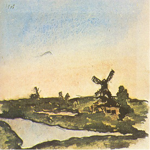
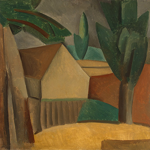
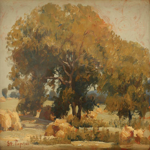
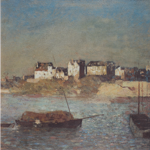
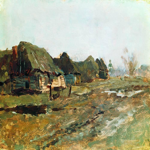
...
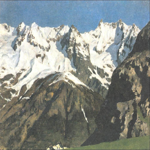
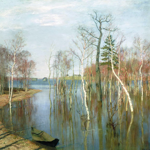
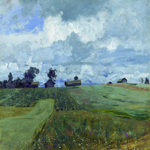
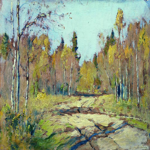
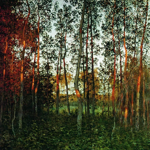

In [ ]:
import ipyplot
ipyplot.plot_images(all_images, max_images=44, img_width=150)

In [ ]:
image_features = torch.empty((0, 512))
step = 1000

for start in range(0, len(all_images), step):
  end = min(start + step, len(all_images))
  print(start, end)
  images = [preprocess(im) for im in all_images[start:end]]
  image_input = torch.tensor(np.stack(images)).cuda()
  image_input -= image_mean[:, None, None]
  image_input /= image_std[:, None, None]
  with torch.no_grad():
    image_feature_batch = model.encode_image(image_input).float()
  image_features = torch.cat([image_features, image_feature_batch.cpu()], dim=0)
  
image_features /= image_features.norm(dim=-1, keepdim=True)

0 1000


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:12: UserWarning: floor_divide is deprecated, and will be removed in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values.
To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor'). (Triggered internally at  ../aten/src/ATen/native/BinaryOps.cpp:601.)
  if sys.path[0] == '':


1000 2000
2000 3000
3000 3368


In [ ]:
import gzip
tokenizer = SimpleTokenizer()

def get_text_features(sentence):
  text_tokens = [tokenizer.encode("%s "%(sentence) + "<|endoftext|>")]
  text_input = torch.zeros(len(text_tokens), model.context_length, dtype=torch.long)
  for i, tokens in enumerate(text_tokens):
    text_input[i, :len(tokens)] = torch.tensor(tokens)
    
  text_input = text_input.cuda()
  with torch.no_grad():
    text_features = model.encode_text(text_input).float()
    text_features /= text_features.norm(dim=-1, keepdim=True)

  return text_features

def get_top_N_semantic_similarity(similarity_list, N, reverse):
  results = zip(range(len(similarity_list)), similarity_list)
  results = sorted(results, key=lambda x: x[1], reverse=reverse)
  top_N_images = []
  scores = []
  indices = []
  for index,score in results[:N]:
    scores.append(score)
    top_N_images.append(all_images[index])
    indices.append(index)
  return scores, top_N_images, indices

scores  [0.31105632, 0.31077307, 0.30887198, 0.30761126, 0.30661607, 0.30597788, 0.304169, 0.3041171, 0.30370167, 0.30296302, 0.30294526, 0.3028098, 0.30278623, 0.30233464, 0.30212855, 0.30192822, 0.30107397, 0.3007542, 0.30064157, 0.3005779, 0.30046195, 0.30024976, 0.30012476, 0.29986367, 0.2997637, 0.29963017, 0.29951686, 0.2995013]



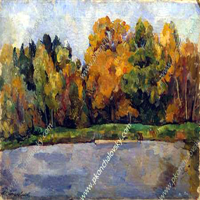
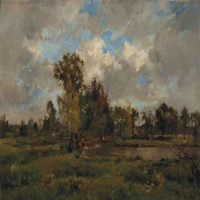
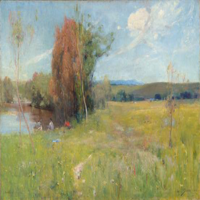
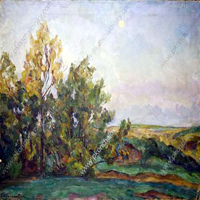
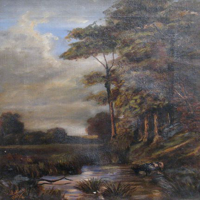
...
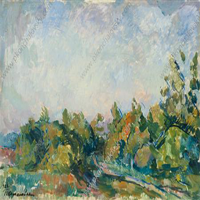
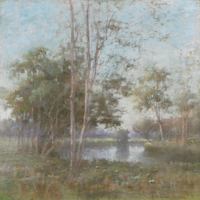
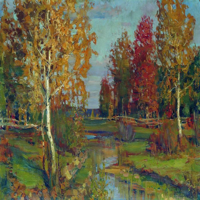
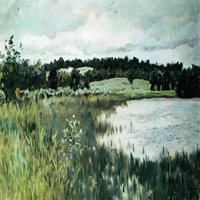
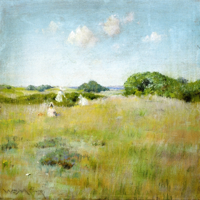

In [ ]:
import html
semantic_search_phrase = "impressionist landscape painting"
text_features_extracted = get_text_features(semantic_search_phrase)
similarity = text_features_extracted.cpu().numpy() @ image_features.cpu().numpy().T

similarity = similarity[0]
scores, imgs, indices = get_top_N_semantic_similarity(similarity, 28, True)
print("scores ", scores)
result_labels = []
ipyplot.plot_images(imgs, img_width=200)

In [ ]:
scores, imgs, indices = get_top_N_semantic_similarity(similarity, 3368, True)

In [ ]:
dictionary = dict(zip(indices, scores))

In [ ]:
dictionary_filtered = dict()
# Iterate over all the items in dictionary and filter items which has even keys
for (key, value) in dictionary.items():
   # Check if key is even then add pair to new dictionary
   if value >=0.23:
       dictionary_filtered[key] = value
print('Filtered Dictionary : ')
print(dictionary_filtered)

Filtered Dictionary : 
{1782: 0.31105632, 2603: 0.31077307, 2744: 0.30887198, 1801: 0.30761126, 170: 0.30661607, 2600: 0.30597788, 1982: 0.304169, 925: 0.3041171, 1306: 0.30370167, 1170: 0.30296302, 1981: 0.30294526, 2379: 0.3028098, 2340: 0.30278623, 3250: 0.30233464, 482: 0.30212855, 802: 0.30192822, 1460: 0.30107397, 982: 0.3007542, 2601: 0.30064157, 2404: 0.3005779, 2295: 0.30046195, 1042: 0.30024976, 2721: 0.30012476, 1792: 0.29986367, 2763: 0.2997637, 2191: 0.29963017, 2210: 0.29951686, 2479: 0.2995013, 2490: 0.29944733, 791: 0.29941362, 1759: 0.29937854, 258: 0.29923087, 117: 0.2992288, 2238: 0.29909655, 2609: 0.29812127, 140: 0.29784048, 1805: 0.2978218, 1104: 0.29779702, 1945: 0.2976817, 1817: 0.29736426, 665: 0.2971791, 1533: 0.29716846, 2604: 0.29711238, 2560: 0.29706994, 2803: 0.29702964, 380: 0.29701895, 2486: 0.29696968, 851: 0.29691982, 2631: 0.29683316, 917: 0.29671624, 892: 0.2966934, 1014: 0.2966745, 1465: 0.29650515, 1878: 0.29650152, 1531: 0.29649875, 2896: 0.29647,

In [ ]:
len(dictionary_filtered) 

3313

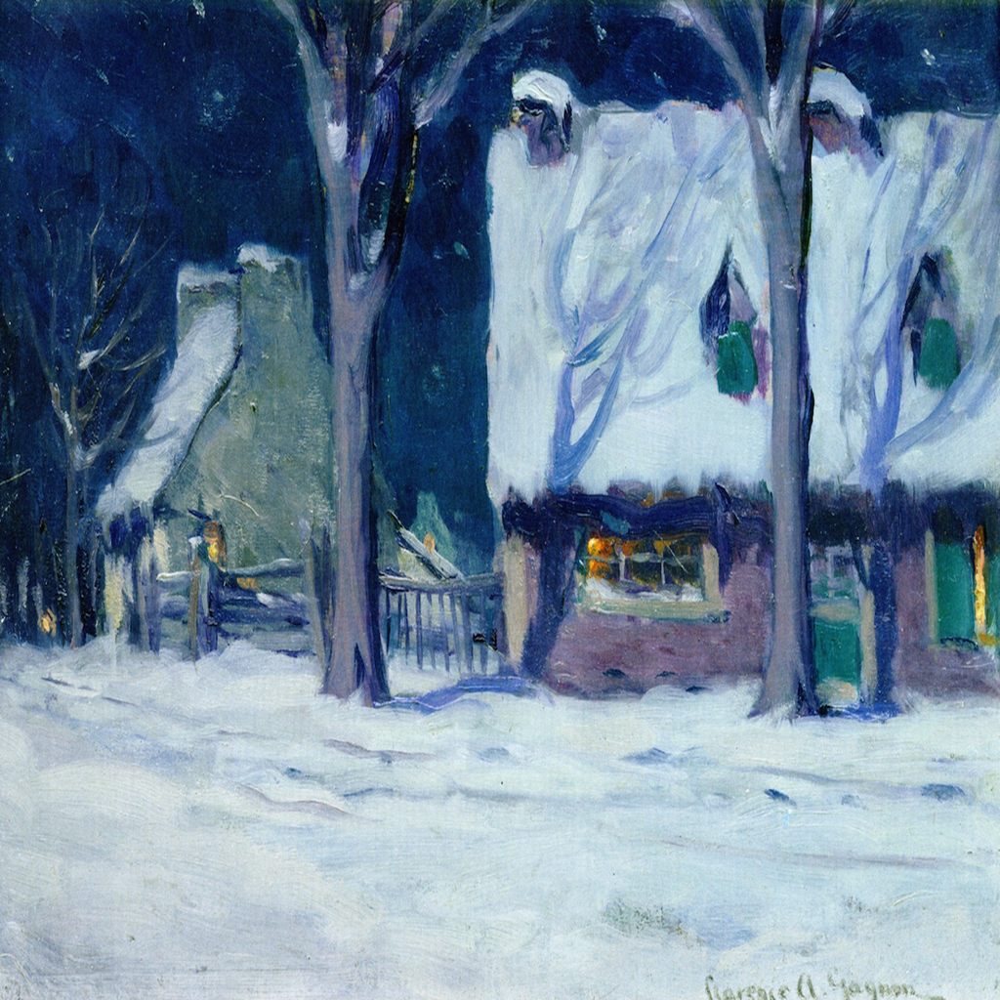

In [ ]:
imgs[3260]

scores  [0.18767573, 0.19805458, 0.20047832, 0.20214617, 0.2055086, 0.20622556, 0.2096422, 0.21068335, 0.21068701, 0.21086754, 0.21087784, 0.21242952, 0.21391411, 0.21658008, 0.21796937, 0.21833387, 0.21844737, 0.21926215, 0.22012766, 0.22046182, 0.22102663, 0.22137162, 0.2214976, 0.22152236, 0.22198862, 0.22209862, 0.22238186, 0.22266029, 0.22334722, 0.22349696, 0.22396158, 0.22413068, 0.22473088, 0.22547403, 0.22562516, 0.22563833, 0.22599782, 0.22600125, 0.22644816, 0.22680962, 0.22699213, 0.2276344, 0.22768846, 0.22813404, 0.22828099, 0.22830687, 0.22861345, 0.2288252, 0.22899057, 0.22936149, 0.2295485, 0.22961433, 0.22980322, 0.22983797, 0.22987369, 0.2301523, 0.23042756, 0.23063327, 0.23074488, 0.23079675, 0.23113792, 0.23155218, 0.23159117, 0.23221375, 0.23235145, 0.2323731, 0.2324217, 0.23253524, 0.23281299, 0.23285195, 0.23312669, 0.23354286, 0.23363633, 0.23374125, 0.23407625, 0.23416449, 0.23421085, 0.2343814, 0.23454064, 0.23463799, 0.23499839, 0.23513117, 0.23528446, 0.235


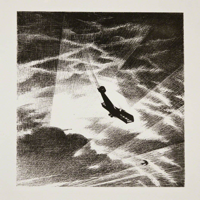
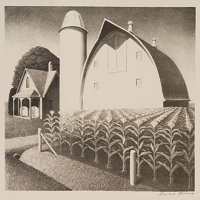
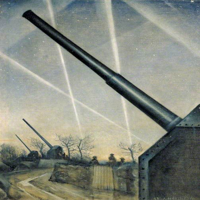
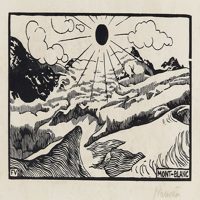
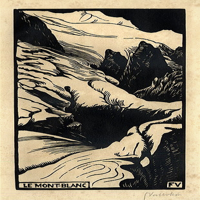
...
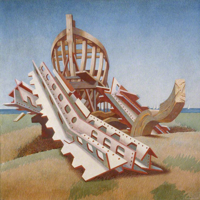
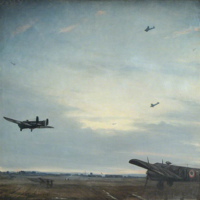
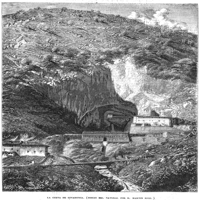
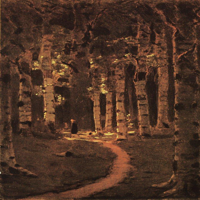
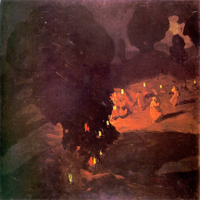

In [ ]:
scores, imgs, indices = get_top_N_semantic_similarity(similarity, 1000, False)
print("scores ", scores)
ipyplot.plot_images(imgs, img_width=200)

scores  [0.31105632, 0.31077307, 0.30887198, 0.30761126, 0.30661607, 0.30597788, 0.304169, 0.3041171, 0.30370167, 0.30296302, 0.30294526, 0.3028098, 0.30278623, 0.30233464, 0.30212855, 0.30192822, 0.30107397, 0.3007542, 0.30064157, 0.3005779, 0.30046195, 0.30024976, 0.30012476, 0.29986367, 0.2997637, 0.29963017, 0.29951686, 0.2995013, 0.29944733, 0.29941362, 0.29937854, 0.29923087, 0.2992288, 0.29909655, 0.29812127, 0.29784048, 0.2978218, 0.29779702, 0.2976817, 0.29736426, 0.2971791, 0.29716846, 0.29711238, 0.29706994, 0.29702964, 0.29701895, 0.29696968, 0.29691982, 0.29683316, 0.29671624, 0.2966934, 0.2966745, 0.29650515, 0.29650152, 0.29649875, 0.29647, 0.2964651, 0.2963574, 0.29623786, 0.2961568, 0.29612678, 0.29609352, 0.29602316, 0.29592246, 0.29568258, 0.2956062, 0.2955472, 0.29552883, 0.29548064, 0.29546824, 0.2954222, 0.2954054, 0.2953136, 0.2952415, 0.29522395, 0.2951185, 0.29494435, 0.2945877, 0.29447022, 0.29439747, 0.29439405, 0.29433882, 0.29432562, 0.2942528, 0.29424882, 


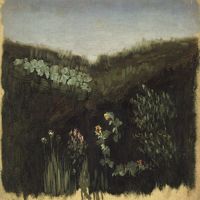
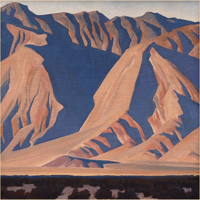
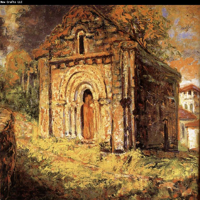
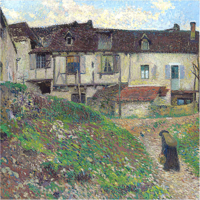
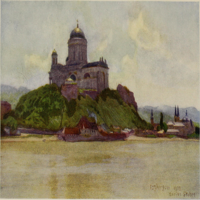
...
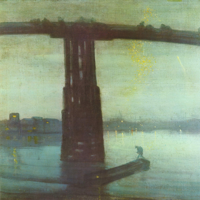
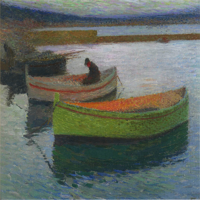
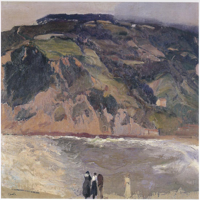
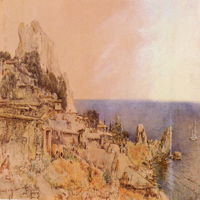
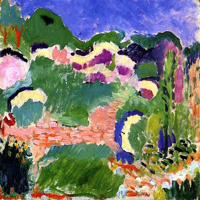

In [ ]:
scores, imgs, indices = get_top_N_semantic_similarity(similarity, 3368, True)
print("scores ", scores)
ipyplot.plot_images(imgs[3000:3368], img_width=200)

In [ ]:
!mkdir '/content/drive/MyDrive/tesi2/dropped_impressionist'

In [ ]:
import shutil
scores, imgs, indices = get_top_N_semantic_similarity(similarity, 3313, False)
for index in indices:
  src_file = image_files[index]
  dst_file = src_file.replace("impressionist_landscape_1024", "dropped_impressionist")
  # print(src_file, dst_file)
  shutil.move(src_file, dst_file)

In [ ]:
!ls /content/drive/MyDrive/tesi2/impressionist_landscape_1024 | wc -l

55


In [ ]:
!ls /content/drive/MyDrive/tesi2/dropped_impressionist | wc -l

3313
